In [1]:
! nvidia-smi

Mon Apr 29 15:13:32 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.129.03             Driver Version: 535.129.03   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla P100-PCIE-16GB           Off | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0              27W / 250W |      0MiB / 16384MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

### Install Dependencies

In [2]:
!pip install -U "transformers>=4.39.0"
!pip install peft bitsandbytes
!pip install -U "trl>=0.8.3"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.0/138.0 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.0/9.0 MB 39.0 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 76.1 MB/s eta 0:00:00:00:01
  Attempting uninstall: tokenizers
    Found existing installation: tokenizers 0.15.2
    Uninstalling tokenizers-0.15.2:
      Successfully uninstalled tokenizers-0.15.2
  Attempting uninstall: transformers
    Found existing installation: transformers 4.39.3
    Uninstalling transformers-4.39.3:
      Successfully uninstalled transformers-4.39.3
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.1/199.1 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.8/119.8 MB 14.6 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 245.2/245.2 kB 11.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.0/102.0 kB 7.9 MB/s eta 0:00:00


In [3]:
import torch
from transformers import AutoTokenizer, AutoProcessor, TrainingArguments, LlavaForConditionalGeneration, BitsAndBytesConfig
from trl import SFTTrainer
from peft import LoraConfig

2024-04-29 15:14:39.278011: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-29 15:14:39.278113: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-29 15:14:39.383968: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


### Load the model (4-bits quantized)

In [4]:
model_id = "llava-hf/llava-1.5-7b-hf"

In [5]:
quantization_config = BitsAndBytesConfig(
    load_in_4bit=True,
)

In [6]:
model = LlavaForConditionalGeneration.from_pretrained(model_id,
                                                      quantization_config=quantization_config,
                                                      torch_dtype=torch.float16)

config.json:   0%|          | 0.00/950 [00:00<?, ?B/s]

/opt/conda/lib/python3.10/site-packages/transformers/models/llava/configuration_llava.py:103: FutureWarning: The `vocab_size` argument is deprecated and will be removed in v4.42, since it can be inferred from the `text_config`. Passing this argument has no effect
  warnings.warn(
`low_cpu_mem_usage` was None, now set to True since model is quantized.


model.safetensors.index.json:   0%|          | 0.00/70.1k [00:00<?, ?B/s]

model-00001-of-00003.safetensors:   0%|          | 0.00/4.99G [00:00<?, ?B/s]

model-00002-of-00003.safetensors:   0%|          | 0.00/4.96G [00:00<?, ?B/s]

model-00003-of-00003.safetensors:   0%|          | 0.00/4.18G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/141 [00:00<?, ?B/s]

### Create a Chat template set `tokenizer` and `processor`

In [7]:
import torch
torch.cuda.empty_cache()

In [8]:
LLAVA_CHAT_TEMPLATE = """A chat between a curious user and an artificial intelligence assistant. The assistant gives helpful, detailed, and polite answers to the user's questions. {% for message in messages %}{% if message['role'] == 'user' %}USER: {% else %}ASSISTANT: {% endif %}{% for item in message['content'] %}{% if item['type'] == 'text' %}{{ item['text'] }}{% elif item['type'] == 'image' %}<image>{% endif %}{% endfor %}{% if message['role'] == 'user' %} {% else %}{{eos_token}}{% endif %}{% endfor %}"""

In [9]:
tokenizer = AutoTokenizer.from_pretrained(model_id)
tokenizer.chat_template = LLAVA_CHAT_TEMPLATE
processor = AutoProcessor.from_pretrained(model_id)
processor.tokenizer = tokenizer

tokenizer_config.json:   0%|          | 0.00/1.33k [00:00<?, ?B/s]

tokenizer.model:   0%|          | 0.00/500k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.84M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/41.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/438 [00:00<?, ?B/s]

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


preprocessor_config.json:   0%|          | 0.00/557 [00:00<?, ?B/s]

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


In [10]:
import io
import PIL.Image as Image

### Create a `DataCollator`

In [11]:
class LLavaDataCollator:
    def __init__(self, processor):
        self.processor = processor

    def __call__(self, examples):
        texts = []
        images = []
        for example in examples:
            messages = example["messages"]
            text = self.processor.tokenizer.apply_chat_template(
                messages, tokenize=False, add_generation_prompt=False
            )
            texts.append(text)
            img = Image.open(io.BytesIO(example['images'][0]['bytes']))
            images.append(img)

        batch = self.processor(texts, images, return_tensors="pt", padding=True)

        labels = batch["input_ids"].clone()
        if self.processor.tokenizer.pad_token_id is not None:
            labels[labels == self.processor.tokenizer.pad_token_id] = -100
        batch["labels"] = labels

        return batch

data_collator = LLavaDataCollator(processor)

### Load the Dataset

In [12]:
from datasets import load_dataset, Dataset

# raw_datasets = load_dataset("HuggingFaceH4/llava-instruct-mix-vsft")
train_dataset = Dataset.load_from_disk('/kaggle/input/metmesuem-data/train.arrow')
eval_dataset = Dataset.load_from_disk('/kaggle/input/metmesuem-data/test.arrow')

In [13]:
train_dataset

Dataset({
    features: ['messages', 'images'],
    num_rows: 80
})

In [14]:
#train_dataset.save_to_disk("/content/drive/MyDrive/lava-instruct-mix-vsft-train")
#eval_dataset.save_to_disk("/content/drive/MyDrive/lava-instruct-mix-vsft-test")

### Set the Training Arguments

In [15]:
training_args = TrainingArguments(
    output_dir="llava-1.5-7b-hf-ft-museum",
    report_to="tensorboard",
    learning_rate=1.4e-5,
    per_device_train_batch_size=2,
    gradient_accumulation_steps=1,
    logging_steps=5,
    num_train_epochs=5,
    push_to_hub=True,
    gradient_checkpointing=True,
    remove_unused_columns=False,
    fp16=True,
    bf16=False
)

### Set the `LoRA` config

In [16]:
lora_config = LoraConfig(
    r=32,
    lora_alpha=16,
    target_modules="all-linear"
)

In [17]:
from huggingface_hub import notebook_login
notebook_login()

### Create the `SFTTrainer`object



In [18]:
trainer = SFTTrainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=eval_dataset,
    peft_config=lora_config,
    dataset_text_field="text",  # need a dummy field
    tokenizer=tokenizer,
    data_collator=data_collator,
    dataset_kwargs={"skip_prepare_dataset": True},
)

/opt/conda/lib/python3.10/site-packages/trl/trainer/sft_trainer.py:246: UserWarning: You didn't pass a `max_seq_length` argument to the SFTTrainer, this will default to 1024
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/trl/trainer/sft_trainer.py:318: UserWarning: You passed a tokenizer with `padding_side` not equal to `right` to the SFTTrainer. This might lead to some unexpected behaviour due to overflow issues when training a model in half-precision. You might consider adding `tokenizer.padding_side = 'right'` to your code.
  warnings.warn(


### Load and set `Tensorboard`for logging

In [19]:
%load_ext tensorboard
%tensorboard --logdir llava-1.5-7b-hf-ft-museum

### Start the training!

In [20]:
trainer.train()

/opt/conda/lib/python3.10/site-packages/torch/utils/checkpoint.py:429: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torch/utils/checkpoint.py:61: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/bitsandbytes/nn/modules.py:426: UserWarning: Input type into Linear4bit is torch.float16, but bnb_4bit_compute_dtype=torch.float32 (default). This will lead to slow inference or training speed.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torch/utils/checkpoint.py:429: UserWarning: torch.utils.checkpoint: please pass in use_

Step,Training Loss
5,3.717900
10,3.763900
15,3.633900
20,3.420100
25,3.312400
30,3.338800
35,3.269800
40,3.030200
45,2.905400
50,2.864900


/opt/conda/lib/python3.10/site-packages/torch/utils/checkpoint.py:429: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torch/utils/checkpoint.py:61: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(


TrainOutput(global_step=200, training_loss=2.173740384578705, metrics={'train_runtime': 2213.3351, 'train_samples_per_second': 0.181, 'train_steps_per_second': 0.09, 'total_flos': 3011293549977600.0, 'train_loss': 2.173740384578705, 'epoch': 5.0})

### Push the model to the HF Hub

In [21]:
trainer.push_to_hub()

/opt/conda/lib/python3.10/site-packages/peft/utils/save_and_load.py:139: UserWarning: Setting `save_embedding_layers` to `True` as embedding layers found in `target_modules`.
  warnings.warn("Setting `save_embedding_layers` to `True` as embedding layers found in `target_modules`.")


tokenizer.model:   0%|          | 0.00/500k [00:00<?, ?B/s]

events.out.tfevents.1714403822.9cf8f581fb93.34.0:   0%|          | 0.00/14.2k [00:00<?, ?B/s]

training_args.bin:   0%|          | 0.00/4.98k [00:00<?, ?B/s]

Upload 4 LFS files:   0%|          | 0/4 [00:00<?, ?it/s]

adapter_model.safetensors:   0%|          | 0.00/908M [00:00<?, ?B/s]

CommitInfo(commit_url='https://huggingface.co/somnathsingh31/llava-1.5-7b-hf-ft-museum/commit/95fabbdffcb23c5e384bf2ea4a760d3d9c17bbd2', commit_message='End of training', commit_description='', oid='95fabbdffcb23c5e384bf2ea4a760d3d9c17bbd2', pr_url=None, pr_revision=None, pr_num=None)

In [22]:

# to save to the local
training_args = TrainingArguments(
    output_dir="llava_model_museum",  # Save to this directory
    push_to_hub=False  # Disable pushing to Hugging Face
)

model.save_pretrained("llava_model_museum", push_to_hub=training_args.push_to_hub)


In [23]:
import shutil

shutil.make_archive('llava_model_museum','zip', '/kaggle/working/llava_model_museum')

'/kaggle/working/llava_model_museum.zip'

### Inference from the model

In [25]:
from peft import PeftModel

model_id = model_id   #base_model id
quantization_config = BitsAndBytesConfig(
    load_in_4bit=True,
)

base_model = LlavaForConditionalGeneration.from_pretrained(model_id,
                                                           quantization_config=quantization_config,
                                                           torch_dtype=torch.float16)

# Load the PEFT Lora model (adapter)
peft_lora_adapter_path = 'somnathsingh31/llava-1.5-7b-hf-ft-museum'      #"Your Hugging face id"
peft_lora_adapter = PeftModel.from_pretrained(base_model, peft_lora_adapter_path, adapter_name="lora_adapter")

# Merge the adapters into the base model
base_model.load_adapter(peft_lora_adapter_path, adapter_name="lora_adapter")

`low_cpu_mem_usage` was None, now set to True since model is quantized.


Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

adapter_config.json:   0%|          | 0.00/927 [00:00<?, ?B/s]

adapter_model.safetensors:   0%|          | 0.00/908M [00:00<?, ?B/s]

In [62]:
import requests

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


Generated response: USER:  
What's the content of the image? ASSISTANT: The image features a chess set, which includes a chessboard, chess pieces, and a box. The chess pieces are white and black, and they are arranged on the chessboard. The chessboard is placed on a table, and the box is also visible in the scene.


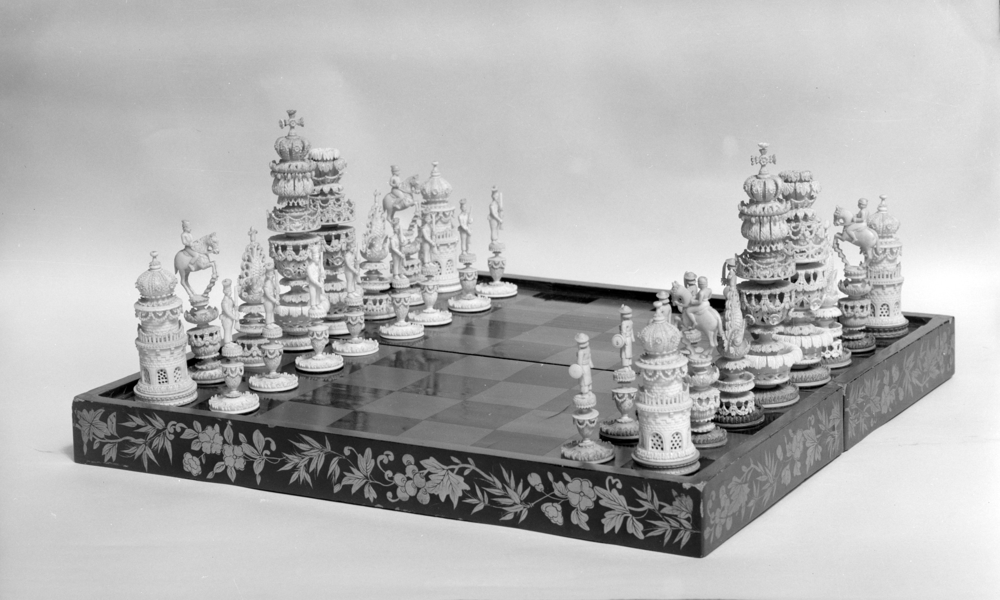

In [63]:
prompt = "USER: <image>\nWhat's the content of the image? ASSISTANT:"
url = "https://images.metmuseum.org/CRDImages/ad/original/138425.jpg"
image = Image.open(requests.get(url, stream=True).raw)
# processor = AutoProcessor.from_pretrained("llava-hf/llava-1.5-7b-hf")
# image = Image.open('/kaggle/input/image-elephant/453367.jpg')
processor = AutoProcessor.from_pretrained(model_id)
inputs = processor(text=prompt, images=image, return_tensors="pt")
# ... process the image and create inputs ...
generate_ids = base_model.generate(**inputs, max_new_tokens=150)
decoded_response = processor.batch_decode(generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False)[0]
print("Generated response:", decoded_response)
image

In [64]:
prompt = "USER: <image>\nWhat is special in this chess set and pieces? \nASSISTANT:"
url = "https://images.metmuseum.org/CRDImages/ad/original/138425.jpg"
image = Image.open(requests.get(url, stream=True).raw)
# processor = AutoProcessor.from_pretrained("llava-hf/llava-1.5-7b-hf")
# image = Image.open('/kaggle/input/image-elephant/453367.jpg')
processor = AutoProcessor.from_pretrained(model_id)
inputs = processor(text=prompt, images=image, return_tensors="pt")
# ... process the image and create inputs ...
generate_ids = base_model.generate(**inputs, max_new_tokens=150)
decoded_response = processor.batch_decode(generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False)[0]
print("Generated response:", decoded_response)

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


Generated response: USER:  
What is special in this chess set and pieces? ASSISTANT: The special aspect of this chess set and pieces is that they are made of ivory, which gives them a unique and antique appearance. The chess pieces are intricately carved, showcasing the craftsmanship of the artist who created them. The set also features a decorative box, which adds to the overall aesthetic appeal of the chess set. The combination of the ivory material, intricate carvings, and the decorative box make this chess set stand out and be considered a valuable and collectible item.


Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


Generated response: USER:  
What type of art is this? ASSISTANT: This is a miniature painting, which is a type of art that typically depicts small, intricate scenes or figures.


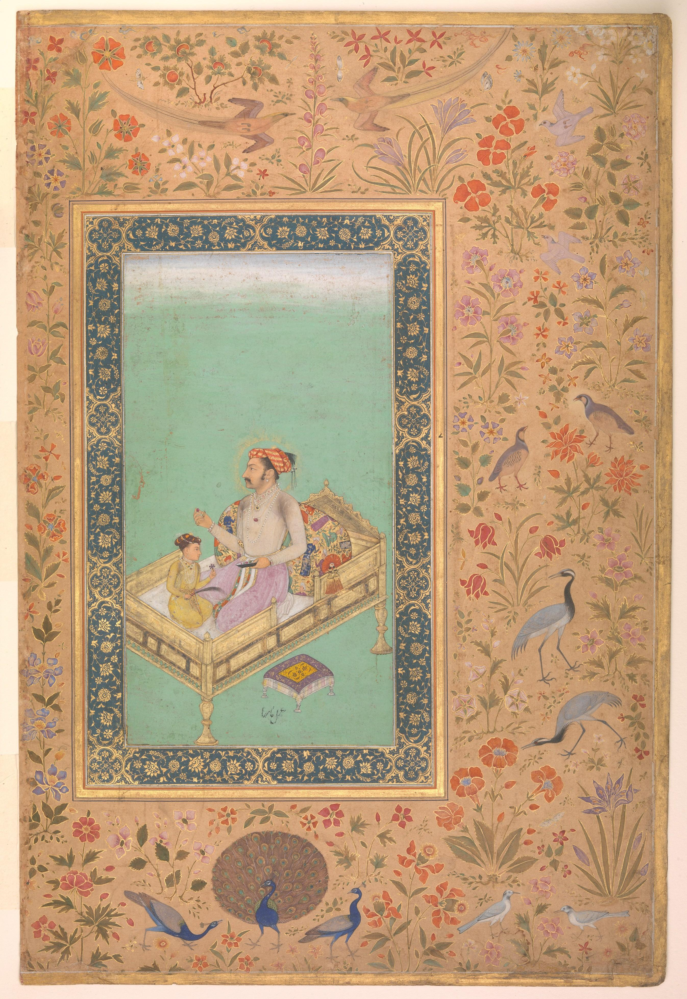

In [68]:
prompt = "USER: <image>\nWhat type of art is this? Tell in detail. \nASSISTANT:"
# url = "https://images.metmuseum.org/CRDImages/ad/original/451283.jpg"
# image = Image.open(requests.get(url, stream=True).raw)
# processor = AutoProcessor.from_pretrained("llava-hf/llava-1.5-7b-hf")
image = Image.open('/kaggle/input/guru-don/451283.jpg')
processor = AutoProcessor.from_pretrained(model_id)
inputs = processor(text=prompt, images=image, return_tensors="pt")
# ... process the image and create inputs ...
generate_ids = base_model.generate(**inputs, max_new_tokens=150)
decoded_response = processor.batch_decode(generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False)[0]
print("Generated response:", decoded_response)
image

In [69]:
prompt = "USER: <image>\nWhat type of art is this? Tell in detail. \nASSISTANT:"
# url = "https://images.metmuseum.org/CRDImages/ad/original/451283.jpg"
# image = Image.open(requests.get(url, stream=True).raw)
# processor = AutoProcessor.from_pretrained("llava-hf/llava-1.5-7b-hf")
image = Image.open('/kaggle/input/guru-don/451283.jpg')
processor = AutoProcessor.from_pretrained(model_id)
inputs = processor(text=prompt, images=image, return_tensors="pt")
# ... process the image and create inputs ...
generate_ids = base_model.generate(**inputs, max_new_tokens=150)
decoded_response = processor.batch_decode(generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False)[0]
print("Generated response:", decoded_response)

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
/opt/conda/lib/python3.10/site-packages/transformers/generation/utils.py:1510: UserWarning: You are calling .generate() with the `input_ids` being on a device type different than your model's device. `input_ids` is on cpu, whereas the model is on cuda. You may experience unexpected behaviors or slower generation. Please make sure that you have put `input_ids` to the correct device by calling for example input_ids = input_ids.to('cuda') before running `.generate()`.
  warnings.warn(


Generated response: USER:  
What type of art is this? Tell in detail. 
ASSISTANT: This is a miniature painting, which is a type of art that originated in the Indian subcontinent. Miniature paintings are small, intricately detailed artworks created using a variety of media, such as ink, pigment, and gold leaf. They often depict scenes from religious texts, historical events, or mythological stories. The artwork in the image features a man and a child, with the man possibly holding a book. The painting is set against a backdrop of a decorative border, which adds to the overall aesthetic appeal of the artwork. The intricate details and the use of various media make this a captivating piece of art.


### Translated Version

In [27]:
!pip install transformers sentencepiece

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [28]:
# We will use MarianMTModel for translation
from transformers import MarianMTModel, MarianTokenizer

In [29]:
# Load the Pre-trained Model and Tokenizer for english to hindi
model_name_en_hi = "Helsinki-NLP/opus-mt-en-hi"  # English to Hindi translation model
tokenizer = MarianTokenizer.from_pretrained(model_name_en_hi)
model_en_hi = MarianMTModel.from_pretrained(model_name_en_hi)

tokenizer_config.json:   0%|          | 0.00/44.0 [00:00<?, ?B/s]

source.spm:   0%|          | 0.00/812k [00:00<?, ?B/s]

target.spm:   0%|          | 0.00/1.07M [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/2.10M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.39k [00:00<?, ?B/s]

/opt/conda/lib/python3.10/site-packages/transformers/models/marian/tokenization_marian.py:175: UserWarning: Recommended: pip install sacremoses.
  warnings.warn("Recommended: pip install sacremoses.")


pytorch_model.bin:   0%|          | 0.00/306M [00:00<?, ?B/s]

/opt/conda/lib/python3.10/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


generation_config.json:   0%|          | 0.00/293 [00:00<?, ?B/s]

In [71]:
# Translates text from source_lang to target_lang using the pre-trained model
def translate_en_hi(text, source_lang="en", target_lang="hi"):
#     text = "\n".join(text.splitlines())
    encoded = tokenizer(text, return_tensors="pt")
    translated = model_en_hi.generate(**encoded, max_length=500)
    return tokenizer.batch_decode(translated, skip_special_tokens=True)[0]

In [31]:
# Load the Pre-trained Model and Tokenizer for hindi to english
model_name_hi_en = "Helsinki-NLP/opus-mt-hi-en"  # Hindi to English translation model
tokenizer_hi = MarianTokenizer.from_pretrained(model_name_hi_en)
model_hi_en = MarianMTModel.from_pretrained(model_name_hi_en)

tokenizer_config.json:   0%|          | 0.00/42.0 [00:00<?, ?B/s]

source.spm:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

target.spm:   0%|          | 0.00/813k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/2.06M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.38k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/304M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/293 [00:00<?, ?B/s]

In [51]:
# Translates text from Hindi to english using the pre-trained model
def translate_hi_en(text, source_lang="hi", target_lang="en"):
    encoded = tokenizer_hi(text, return_tensors="pt")
    translated = model_hi_en.generate(**encoded, max_length=500)
    return tokenizer_hi.batch_decode(translated, skip_special_tokens=True)[0]

In [73]:
def ask_vlm(prompt_hindi, image_path):
  prompt_eng = translate_hi_en(prompt_hindi)
  prompt = "USER: <image>\n" + prompt_eng + " ASSISTANT:"
  image = Image.open(image_path)
  processor = AutoProcessor.from_pretrained(model_id)
  inputs = processor(text=prompt, images=image, return_tensors="pt")
  # ... process the image and create inputs ...
  generate_ids = base_model.generate(**inputs, max_new_tokens=250)
  decoded_response = processor.batch_decode(generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False)[0]
  # Find index of "ASSISTANT:"
  assistant_index = decoded_response.find("ASSISTANT:")

  # Extract text after "ASSISTANT:"
  if assistant_index != -1:
      text_after_assistant = decoded_response[assistant_index + len("ASSISTANT:"):]
      # Remove leading and trailing whitespace
      text_after_assistant = text_after_assistant.strip()
  else:
    None

  text_hindi = translate_en_hi(text_after_assistant)
  return text_hindi


In [74]:
output_vlm = ask_vlm('यह किस प्रकार की कला है? विस्तार से बताओ.', '/kaggle/input/image-elephant/453367.jpg')

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


In [75]:
print(output_vlm)

कला एक चित्र या चित्र है, संभवतः एक भारतीय लघु चित्र है, जो एक हाथी को उसकी पीठ पर सवार एक आदमी के साथ रखता है ।
